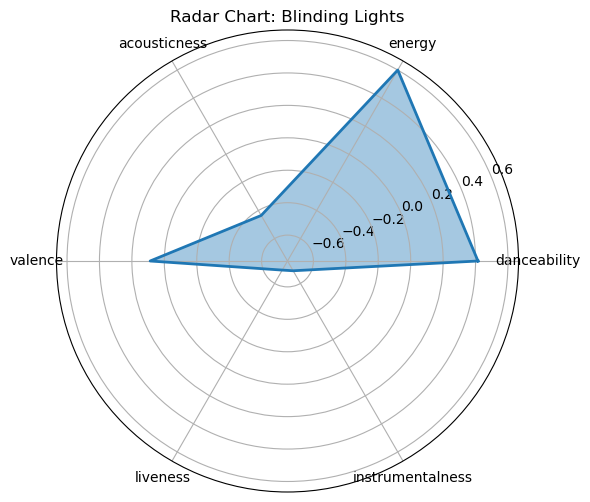

/var/folders/fq/g897wng54x73hj9ss__c8p7c0000gn/T/ipykernel_13675/3818437198.py:83: UserWarning: Glyph 127919 (\N{DIRECT HIT}) missing from current font.
  plt.tight_layout()
/Users/keerthichowdarygogineni/anaconda3/lib/python3.11/site-packages/IPython/core/pylabtools.py:152: UserWarning: Glyph 127919 (\N{DIRECT HIT}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


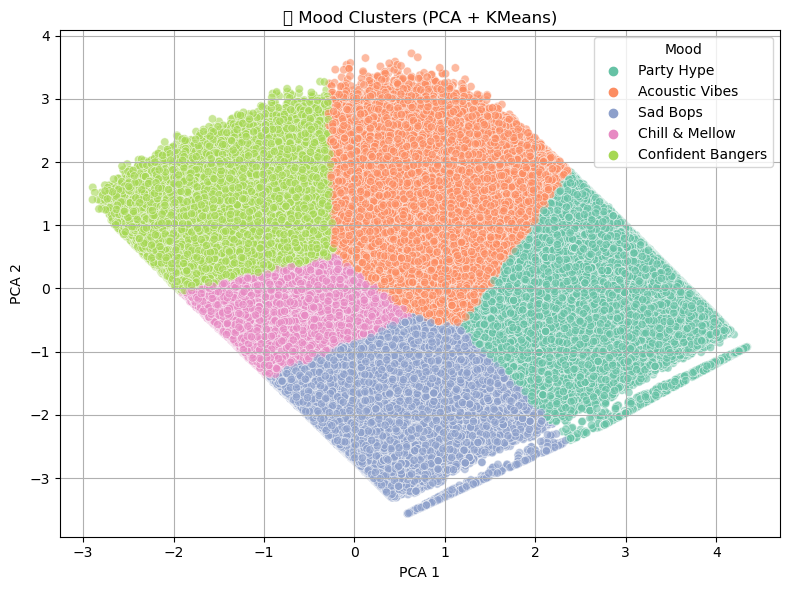

🎯 Popularity Prediction RMSE: 15.63


/var/folders/fq/g897wng54x73hj9ss__c8p7c0000gn/T/ipykernel_13675/3818437198.py:137: UserWarning:

Glyph 128293 (\N{FIRE}) missing from current font.

/Users/keerthichowdarygogineni/anaconda3/lib/python3.11/site-packages/IPython/core/pylabtools.py:152: UserWarning:

Glyph 128293 (\N{FIRE}) missing from current font.



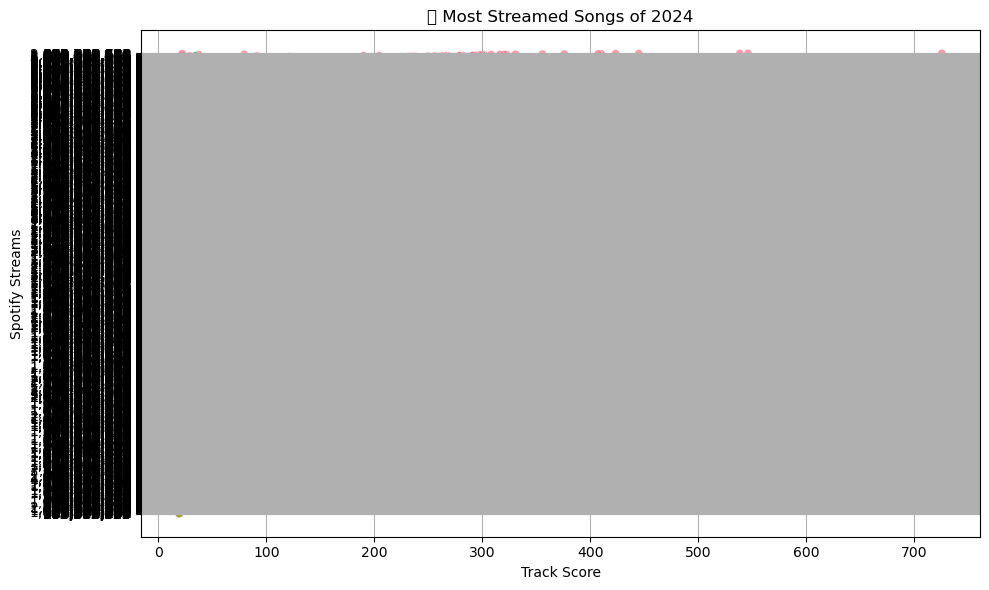

In [1]:
# mood_dashboard.py

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from math import pi

# Load Data
data = pd.read_csv("data/data_w_genres.csv")
data_1m = pd.read_csv("data/spotify_data.csv")
data_2024 = pd.read_csv("data/Most Streamed Spotify Songs 2024.csv", encoding="ISO-8859-1")

# ================= SECTION 1: Radar Chart (Normalized) =================

def plot_radar(data, track_name, normalize=True):
    track = data[data['track_name'] == track_name]
    if track.empty:
        print(f"❌ Track '{track_name}' not found!")
        return

    row = track.iloc[0]
    labels = ['danceability', 'energy', 'acousticness', 'valence', 'liveness', 'instrumentalness']
    values = [row[label] for label in labels]

    if normalize:
        mean_vals = data[labels].mean()
        std_vals = data[labels].std()
        values = [(row[label] - mean_vals[label]) / std_vals[label] for label in labels]

    values += values[:1]  # loop back to first
    angles = [n / float(len(labels)) * 2 * pi for n in range(len(labels))]
    angles += angles[:1]

    fig, ax = plt.subplots(figsize=(6, 6), subplot_kw=dict(polar=True))
    ax.plot(angles, values, linewidth=2)
    ax.fill(angles, values, alpha=0.4)
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(labels)
    ax.set_title(f"Radar Chart: {track_name}")
    plt.show()

# ✅ Example usage:
plot_radar(data_1m, "Blinding Lights")

# ================= SECTION 2: Mood Clusters + Labels =================

features = ['valence', 'energy', 'danceability', 'acousticness']
X = data_1m[features].dropna()
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)

kmeans = KMeans(n_clusters=5, random_state=42, n_init='auto')
clusters = kmeans.fit_predict(X_pca)

# Custom mood labels
mood_labels = {
    0: "Chill & Mellow",
    1: "Party Hype",
    2: "Sad Bops",
    3: "Confident Bangers",
    4: "Acoustic Vibes"
}
data_1m['Cluster'] = clusters
data_1m['Mood'] = data_1m['Cluster'].map(mood_labels)

# 🎯 PCA Mood Cluster Plot
plt.figure(figsize=(8, 6))
sns.scatterplot(x=X_pca[:, 0], y=X_pca[:, 1], hue=data_1m['Mood'], palette='Set2', alpha=0.6)
plt.title("🎯 Mood Clusters (PCA + KMeans)")
plt.xlabel("PCA 1")
plt.ylabel("PCA 2")
plt.grid(True)
plt.tight_layout()
plt.show()

# ================= SECTION 3: Mood Map (Valence vs Energy) =================

# Optional interactive version using plotly
try:
    import plotly.express as px
    fig = px.scatter(
        data_frame=data,
        x="valence",
        y="energy",
        color="genres",
        hover_data=["artists"],
        title="🎨 Mood Map: Valence vs Energy by Genre (Interactive)"
    )
    fig.show()
except ImportError:
    plt.figure(figsize=(10, 6))
    sns.scatterplot(data=data, x="valence", y="energy", hue="genres", alpha=0.6, legend=False)
    plt.title("🎨 Mood Map: Valence vs Energy by Genre")
    plt.xlabel("Valence (Happiness)")
    plt.ylabel("Energy")
    plt.grid(True)
    plt.tight_layout()
    plt.show()

# ================= SECTION 4: Predicting Popularity =================

X_pop = data_1m[features].dropna()
y_pop = data_1m.loc[X_pop.index, 'popularity']

X_train, X_test, y_train, y_test = train_test_split(X_pop, y_pop, test_size=0.2, random_state=42)
model = RandomForestRegressor(n_estimators=100, random_state=42)
model.fit(X_train, y_train)
preds = model.predict(X_test)
rmse = mean_squared_error(y_test, preds, squared=False)
print(f"🎯 Popularity Prediction RMSE: {rmse:.2f}")

# ================= SECTION 5: 2024 Highlights =================

plt.figure(figsize=(10, 6))
sns.scatterplot(
    data=data_2024,
    x="Track Score",
    y="Spotify Streams",
    hue="Artist",
    alpha=0.7,
    legend=False
)
plt.title("🔥 Most Streamed Songs of 2024")
plt.xlabel("Track Score")
plt.ylabel("Spotify Streams")
plt.grid(True)
plt.tight_layout()
plt.show()